In [1]:
import keras
from keras import backend as K
import numpy as np
from matplotlib import pyplot as plt
from scipy.misc import imread, imresize
import os
import random

Using TensorFlow backend.


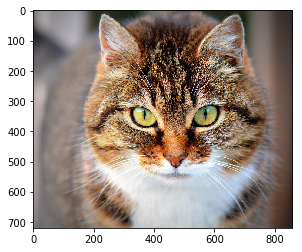

In [2]:
mean_pixel = [103.939, 116.779, 123.68]
mean_pixel = np.array(mean_pixel)

cat = imread('cat.jpg')
plt.imshow(cat)
plt.show()

In [3]:
from keras.applications.vgg16 import VGG16
from keras.models import Model

model = VGG16(weights='imagenet', include_top=False, input_shape=cat.shape)
new_model = model

In [4]:
cat = cat - mean_pixel
out = model.predict(cat[np.newaxis])
out.shape

(1, 22, 26, 512)

In [5]:
test_base = 'data/image/'
image_name_test = []
for file in os.listdir(test_base):
    if file.endswith('.jpg'):
        image_name_test.append(file)
len(image_name_test)

5063

In [6]:
image_num = len(image_name_test)

In [7]:
out = np.load('aggregated-features.npy')

In [8]:
out.shape

(5063, 512)

In [9]:
query_dir = 'data/gt_files_170407/'
query_list = []
for file in os.listdir(query_dir):
    if file.endswith('_query.txt'):
        query_list.append(file)
len(query_list)

55

(1, 20)


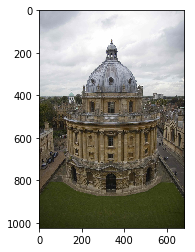

2694


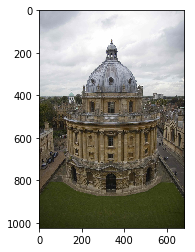

589


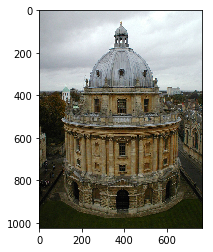

2684


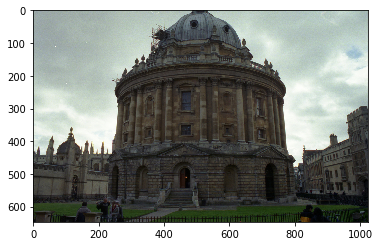

1779


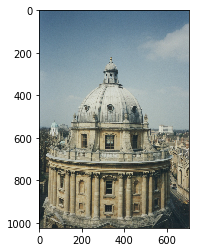

1981


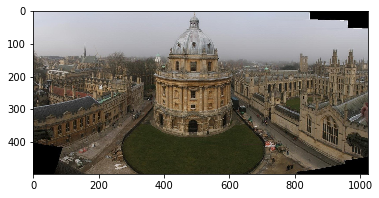

1497


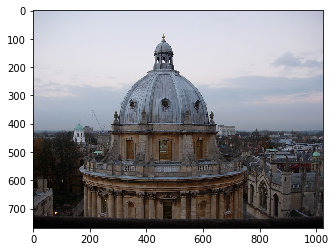

2513


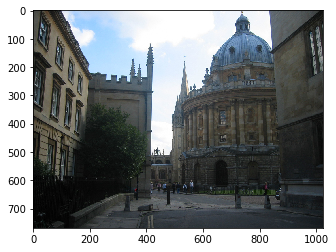

2583


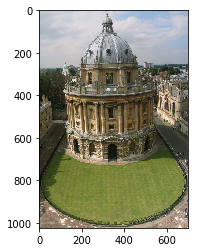

528


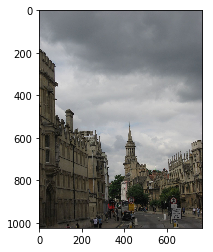

3743


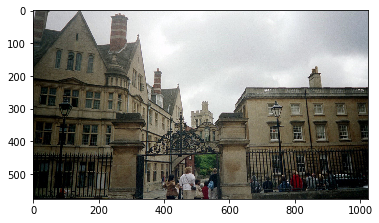

3746


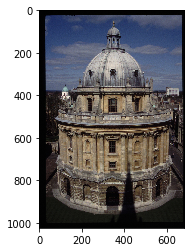

1417


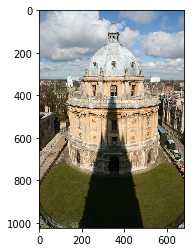

1101


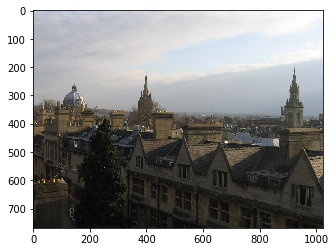

3224


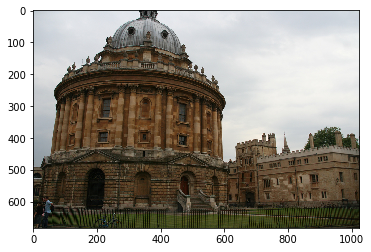

1028


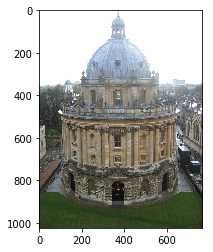

3627


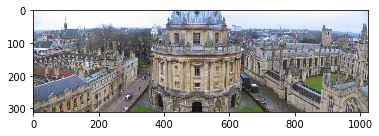

3502


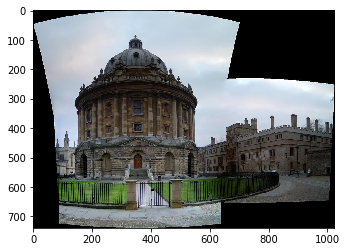

5


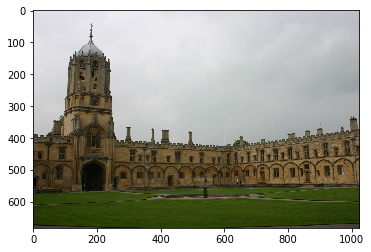

3583


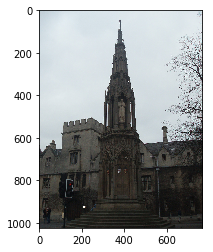

554


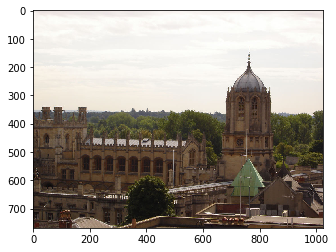

In [10]:
query = 'hertford_000027'
query = query + '.jpg'
index = image_name_test.index(query)
n_neighbors = 20

query = random.choice(query_list)
with open(query_dir+query) as f:
    query = f.read().split()[0]
    query = query[5:]
    query = query + '.jpg'
    
index = image_name_test.index(query)
    
from sklearn.neighbors import NearestNeighbors as NN
nn = NN()
nn.fit(out)
neighbors = nn.kneighbors(out[index][np.newaxis,:], n_neighbors=n_neighbors, 
                          return_distance=False)
print neighbors.shape

image = imread(test_base+image_name_test[index])
plt.imshow(image)
plt.show()

for neighbor in np.nditer(neighbors):
    # the first should be the query image
    print neighbor
    image = imread(test_base+image_name_test[neighbor])
    plt.imshow(image)
    plt.show()

In [11]:
def compute_ap(pos, amb, rank, debug = False):
    old_recall = 0.0
    old_precision = 1.0
    ap = 0.0
    
    intersect_size = 0
    i = 0
    j = 0
    
    for i in range(len(rank)):
        if rank[i] in amb:
            continue
        if rank[i] in pos:
            intersect_size += 1
        if False:
            # this is wrong
            recall = intersect_size / float(len(pos))
            precision = intersect_size / (j + 1.0)
            
            ap += (recall - old_recall) * ((old_precision + precision)/2.0)
            
            old_recall = recall
            old_precision = precision;
            j += 1
        else:
            if rank[i] in pos:
                ap0 = intersect_size / float(i+1.0)
                ap += ap0
                
                if debug:
                    print 'ap0'
                    print ap0
                    print 'min'
                    print min(float(len(pos)),len(rank))
    if False:
        return ap
    else:
        ap = ap / min(float(len(pos)),len(rank))
        return ap

In [12]:
def load_list(file):
    with open(file, 'r') as f:
        l = []
        for line in f:
            l.append(line.rstrip('\n'))
        return l

In [32]:
def compute_ap2(query, rank, query_dir, image_dir='data/image/',debug=False, display_pos=False):
    # here query is the name of picture, include .jpg
    query = query[:-10]
    good_set = load_list(query_dir+query+'_good.txt')
    ok_set = load_list(query_dir+query+'_ok.txt')
    junk_set = load_list(query_dir+query+'_junk.txt')
    
    pos_set = good_set + ok_set
    if debug:
        print 'pos_set'
        print pos_set
    if display_pos:
        for image in pos_set:
            img = imread(image_dir+image+'.jpg')
            plt.imshow(img)
            plt.show()
    
    ap = compute_ap(pos_set, junk_set, rank)
    return ap

In [14]:
# convert the index to image name, meanwhile delete the first index because it is the query image
def i2name(l, d):
    l2 = []
    l = l.reshape(-1)
    l = l.tolist()
    if False:
        print 'len {}'.format(len(l))
    for item in l:        
        l2.append(d[item][:-4])
        
    return l2

    # because sometime the query image is not in rank 1
    return l2[1:]

In [15]:
def get_query_image(query, query_dir, debug = False):
    if debug:
        print 'get_query_image query is {}'.format(query)
    with open(query_dir+query) as f:
        query = f.read().split()
        position = []
        for i in [1,2,3,4]:
            position.append(query[i])
            
        query = query[0]
        query = query[5:]
        query = query + '.jpg'
    return query, position

In [16]:
def preprocessing(out, query=None, params={}, normalize=0, pca=-1, ica=-1, ica_iter=200):
    # ica_iter=200 is default value of FastICA
    
    if normalize == 0:
        normalize = params.get('normalize', 0)
    if pca == -1:
        pca = params.get('pca', -1)
    if ica == -1:
        ica = params.get('ica', -1)
    if ica_iter == 200:
        ica_iter = params.get('ica_iter', 200)
    
    if normalize >= 1:
        from sklearn.preprocessing import normalize as sknormalize
        out = sknormalize(out)
        if query != None:
            query = sknormalize(query)
    
    if pca >= 0:
        from sklearn.decomposition import PCA
        pca = PCA(whiten=True, random_state=0)
        pca.fit(out)
        out = pca.transform(out)
        if query != None:
            query = pca.transform(query)
        
    if ica >= 0:
        from sklearn.decomposition import FastICA
        ica = FastICA(max_iter=ica_iter)
        ica.fit(out)
        out = ica.transform(out)
        if query != None:
            query = pca.transform(query)
        
    if normalize >= 2:
        out = sknormalize(out)
        if query != None:
            query = sknormalize(query)
            
    if query != None:
        return out, query
    else:
        return out

In [17]:
def get_query(query, query_dir, image_name_test, out, image_dir='/data/image/',
              crop = False, debug = False):
    # the input query is the query file e.g. XXXX_query
    # return the name of query image and parch coordinate
    if debug:
        print 'get_query query is {}'.format(query)
        
    query, position = get_query_image(query, query_dir)
    
    index = image_name_test.index(query)
    target = out[index][np.newaxis,:]
    
    clear_every = 1
    
    if crop:
        x, y, x2, y2 = position
        (x, y, x2, y2) = map(float, (x, y, x2, y2))
        (x, y, x2, y2) = map(round, (x, y, x2, y2))
        
        (x, y, x2, y2) = map(int, (x, y, x2, y2))
        
        image = imread(image_dir+query)
        
        if debug:
            print 'show uncropped image'
            plt.imshow(image)
            plt.show()

        # the subscripts of image and numpy is different
        image = image[y:y2,x:x2]

        if debug:
            plt.imshow(image)
            plt.show()

        if debug:
            print query
            print position

        compute_neighbors.counter += 1
        if debug:
            print 'compute_neighbors: This is {} calls'.format(compute_neighbors.counter)
        if compute_neighbors.counter == clear_every:
            import keras.backend as K
            K.clear_session()

        model = VGG16(weights='imagenet', include_top=False, 
                          input_shape=image.shape)
        target = model.predict(image[np.newaxis,:]).sum(axis=(1,2))    
        
    return target

In [18]:
def compute_neighbors2(target, out, debug = False):
    
    # query    here query is the query file e.g XXXXX_query.txt

    if debug:
        print out.shape
    N, D = out.shape
    n_neighbors = image_num/2

    from sklearn.neighbors import NearestNeighbors as NN
    nn = NN()
    nn.fit(out)
    neighbors = nn.kneighbors(target, n_neighbors=n_neighbors, 
                              return_distance=False)
    return neighbors

In [19]:
def compute_neighbors(query, query_dir, image_name_test, out, 
                      image_dir='data/image/', crop = False, pre_params = {}, debug = False):
    
    # query    here query is the query file e.g XXXXX_query.txt
    query, position = get_query_image(query, query_dir)
    
    index = image_name_test.index(query)
    target = out[index][np.newaxis,:]
    
    clear_every = 1
    
    if crop:
        
        if False:
            x = position[0]
            y = position[1]
            w = position[2]
            h = position[3]
            (x, y, w, h) = map(float, (x, y, w, h))
        
            x2 = round(x + w)
            y2 = round(y + h)
            x = round(x)
            y = round(y)
        else:
            x, y, x2, y2 = position
            (x, y, x2, y2) = map(float, (x, y, x2, y2))
            (x, y, x2, y2) = map(round, (x, y, x2, y2))
        
        (x, y, x2, y2) = map(int, (x, y, x2, y2))
        
        image = imread(image_dir+query)
        
        if debug:
            print 'show uncropped image'
            plt.imshow(image)
            plt.show()
        
        # the subscripts of image and numpy is different
        image = image[y:y2,x:x2]
        
        if debug:
            plt.imshow(image)
            plt.show()
        
        if debug:
            print query
            print position
        
        compute_neighbors.counter += 1
        if debug:
            print 'compute_neighbors: This is {} calls'.format(compute_neighbors.counter)
        if compute_neighbors.counter == clear_every:
            import keras.backend as K
            K.clear_session()
        
        model = VGG16(weights='imagenet', include_top=False, 
                      input_shape=image.shape)
        target = model.predict(image[np.newaxis,:]).sum(axis=(1,2))
        _, target = preprocessing(out, query=target, params=pre_params)
    
    if debug:
        print out.shape
    N, D = out.shape
    n_neighbors = image_num/2

    from sklearn.neighbors import NearestNeighbors as NN
    nn = NN()
    nn.fit(out)
    neighbors = nn.kneighbors(target, n_neighbors=n_neighbors, 
                              return_distance=False)
    return neighbors

In [20]:
ap = []
name_dict = dict(enumerate(image_name_test))
for file in query_list:
    neighbors = compute_neighbors(file, query_dir, image_name_test, out)
    rank = i2name(neighbors, name_dict)
    ap0 = compute_ap2(file, rank, query_dir)
    ap.append(ap0)
    
np.mean(np.array(ap))

0.46405776616304634

# Adding Normalization

In [21]:
ap = []
params = {}
params['normalize'] = 1
for file in query_list:
    features = preprocessing(out, params=params)
    neighbors = compute_neighbors(file, query_dir, image_name_test, features, pre_params=params)
    rank = i2name(neighbors, name_dict)
    ap0 = compute_ap2(file, rank, query_dir)
    ap.append(ap0)
np.mean(np.array(ap))

0.54682069165955827

# Adding whitening and PCA

In [22]:
ap = []
params = {}
params['normalize'] = 1
params['pca'] = 0
features = preprocessing(out, normalize=1, pca=0)
for file in query_list:
    neighbors = compute_neighbors(file, query_dir, image_name_test, features, pre_params=params)
    rank = i2name(neighbors, name_dict)
    ap0 = compute_ap2(file, rank, query_dir)
    ap.append(ap0)
np.mean(np.array(ap))

0.43403621388976693

# Adding normalization after PCA

In [23]:
ap = []
params = {}
params['normalize'] = 2
params['pca'] = 0
features = preprocessing(out, normalize=2, pca=0)
for file in query_list:
    neighbors = compute_neighbors(file, query_dir, image_name_test, features, pre_params=params)
    rank = i2name(neighbors, name_dict)
    ap0 = compute_ap2(file, rank, query_dir)
    ap.append(ap0)
np.mean(np.array(ap))

0.5808267964297178

# Crop image

query file name is christ_church_2_query.txt
get_query query is christ_church_2_query.txt


/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:16: FutureWarning: comparison to `None` will result in an elementwise object comparison in the future.
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:24: FutureWarning: comparison to `None` will result in an elementwise object comparison in the future.
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:37: FutureWarning: comparison to `None` will result in an elementwise object comparison in the future.
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:40: FutureWarning: comparison to `None` will result in an elementwise object comparison in the future.


(5063, 512)
pos_set
['christ_church_000179', 'christ_church_000450', 'christ_church_000104', 'christ_church_000696', 'christ_church_000279', 'christ_church_000308', 'christ_church_000366', 'christ_church_001070', 'christ_church_000078', 'christ_church_000549', 'christ_church_000999', 'oxford_001666', 'christ_church_000447', 'christ_church_000061', 'christ_church_000146', 'christ_church_000333', 'christ_church_000758', 'christ_church_000976', 'christ_church_000198', 'christ_church_000996', 'christ_church_000664', 'christ_church_001045', 'christ_church_000681', 'christ_church_000642', 'christ_church_001142', 'christ_church_000532', 'oxford_002734', 'christ_church_000645', 'christ_church_000757', 'christ_church_000035', 'christ_church_000802', 'christ_church_000395', 'christ_church_000623', 'christ_church_000436', 'christ_church_000073', 'christ_church_000718', 'christ_church_000228', 'christ_church_000911', 'christ_church_000212', 'christ_church_000190', 'christ_church_000064', 'christ_c

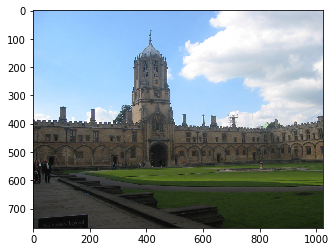

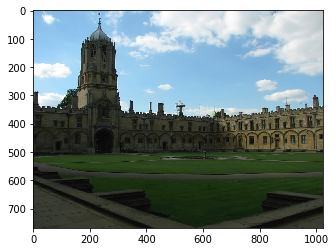

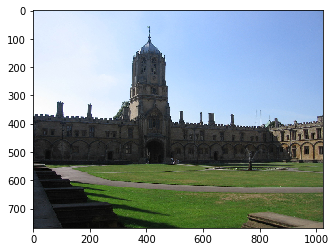

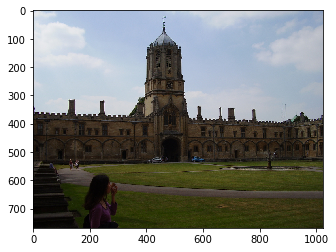

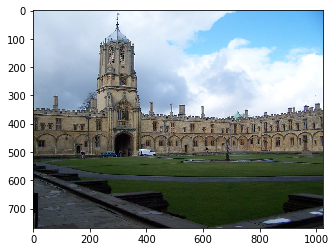

...

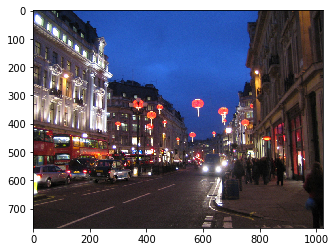

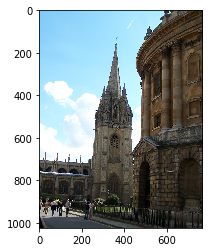

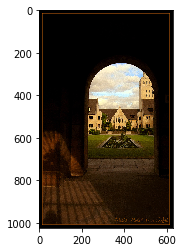

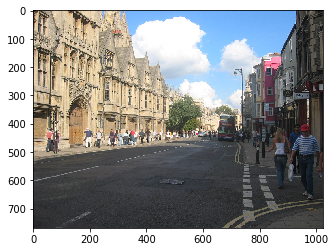

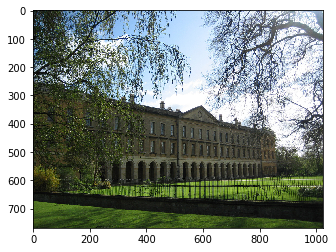

rank
['oxford_002734', 'christ_church_000664', 'christ_church_000549', 'christ_church_000911', 'christ_church_000179', 'christ_church_000718', 'christ_church_000190', 'christ_church_000532', 'christ_church_000212', 'oxford_002888', 'christ_church_000681', 'christ_church_000886', 'christ_church_000228', 'christ_church_000146', 'christ_church_000078', 'christ_church_001142', 'christ_church_000802', 'christ_church_000623', 'christ_church_000999', 'christ_church_000673', 'christ_church_000395', 'oxford_000693', 'christ_church_000976', 'christ_church_000450', 'christ_church_000435', 'christ_church_000738', 'christ_church_000376', 'magdalen_000669', 'christ_church_000436', 'christ_church_000366', 'christ_church_000311', 'christ_church_000974', 'christ_church_000932', 'christ_church_001070', 'oxford_002858', 'christ_church_000061', 'christ_church_000104', 'christ_church_001033', 'christ_church_000754', 'oxford_000158', 'all_souls_000062', 'oxford_000624', 'radcliffe_camera_000439', 'christ_ch

0.55972224680764249

In [28]:
# use full image compute ap, get 0.58
# use cropped image, get ~0.45
# why

debug = True
ap = []
params = {}
params['normalize'] = 2
params['pca'] = 0
features = preprocessing(out, normalize=2, pca=0)
compute_neighbors.counter = 0
K.clear_session()
image_dir = 'data/image/'

for file in query_list:
    if debug:
        print 'query file name is {}'.format(file)
    target = get_query(file, query_dir, image_name_test, out, image_dir='data/image/',
              crop = False, debug = debug)
    if False:
        print 'target is'
        print target
    _, target = preprocessing(out, query = target, params=params)
    if False:
        print 'after preprocessing, target is'
        print target
    
    neighbors = compute_neighbors2(target, features, debug = debug)
    rank = i2name(neighbors, name_dict)
    ap0 = compute_ap2(file, rank, query_dir, debug = debug)
    ap.append(ap0)
    
    if debug:
        for image in rank[:100]:
            img = imread(image_dir+image+'.jpg')
            plt.imshow(img)
            plt.show()
    
    if debug:
        print 'rank'
        print rank[0:100]
        print 'ap0 is {}'.format(ap0)
    
    if True:
        break
    
np.mean(np.array(ap))

query file name is christ_church_2_query.txt
get_query query is christ_church_2_query.txt
show uncropped image


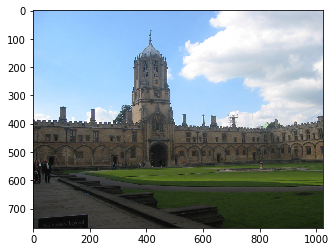

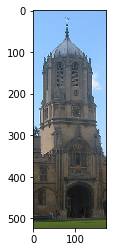

oxford_002734.jpg
['333', '53', '509', '576']
compute_neighbors: This is 1 calls


/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:16: FutureWarning: comparison to `None` will result in an elementwise object comparison in the future.
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:24: FutureWarning: comparison to `None` will result in an elementwise object comparison in the future.
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:37: FutureWarning: comparison to `None` will result in an elementwise object comparison in the future.
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:40: FutureWarning: comparison to `None` will result in an elementwise object comparison in the future.


(5063, 512)
pos_set
['christ_church_000179', 'christ_church_000450', 'christ_church_000104', 'christ_church_000696', 'christ_church_000279', 'christ_church_000308', 'christ_church_000366', 'christ_church_001070', 'christ_church_000078', 'christ_church_000549', 'christ_church_000999', 'oxford_001666', 'christ_church_000447', 'christ_church_000061', 'christ_church_000146', 'christ_church_000333', 'christ_church_000758', 'christ_church_000976', 'christ_church_000198', 'christ_church_000996', 'christ_church_000664', 'christ_church_001045', 'christ_church_000681', 'christ_church_000642', 'christ_church_001142', 'christ_church_000532', 'oxford_002734', 'christ_church_000645', 'christ_church_000757', 'christ_church_000035', 'christ_church_000802', 'christ_church_000395', 'christ_church_000623', 'christ_church_000436', 'christ_church_000073', 'christ_church_000718', 'christ_church_000228', 'christ_church_000911', 'christ_church_000212', 'christ_church_000190', 'christ_church_000064', 'christ_c

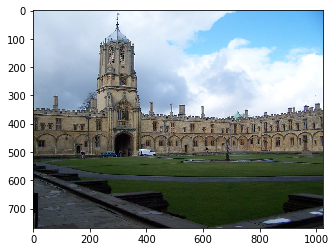

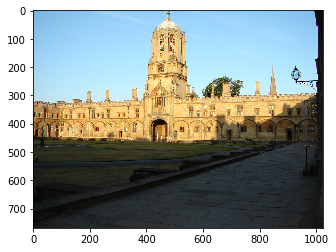

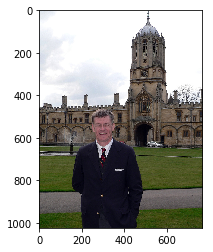

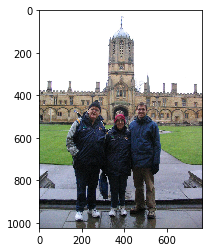

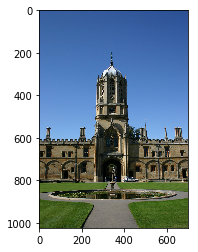

...

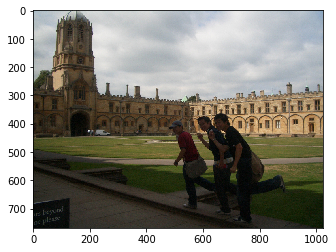

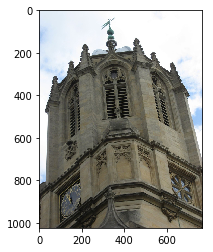

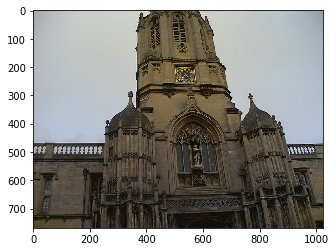

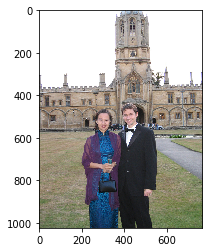

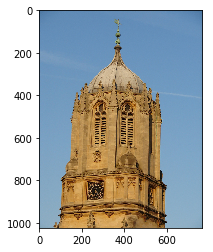

rank
['christ_church_000451', 'christ_church_001039', 'oxford_002734', 'oxford_003325', 'oxford_002704', 'christ_church_000724', 'oxford_002562', 'christ_church_000314', 'oxford_000866', 'christ_church_000222', 'christ_church_000626', 'christ_church_000664', 'oxford_001666', 'oxford_002501', 'christ_church_000873', 'oxford_001343', 'keble_000214', 'christ_church_000549', 'christ_church_000283', 'christ_church_000363', 'christ_church_000559', 'christ_church_000999', 'oxford_002678', 'oxford_001147', 'christ_church_000906', 'magdalen_001148', 'trinity_000328', 'oxford_002317', 'christ_church_000115', 'oxford_002701', 'radcliffe_camera_000113', 'oxford_002817', 'christ_church_000863', 'oxford_002347', 'christ_church_000190', 'keble_000245', 'christ_church_001078', 'cornmarket_000022', 'christ_church_000372', 'keble_000227', 'christ_church_000718', 'oxford_000620', 'oxford_000588', 'all_souls_000044', 'oxford_001413', 'oxford_001402', 'oxford_000404', 'radcliffe_camera_000360', 'keble_0002

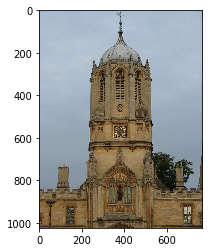

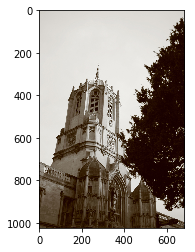

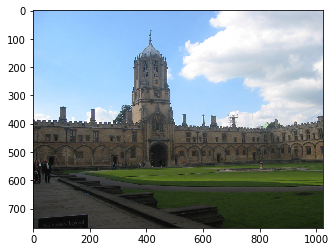

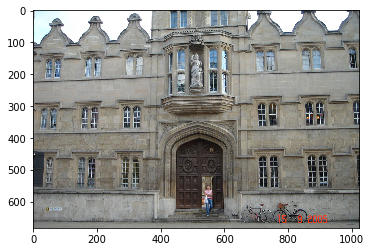

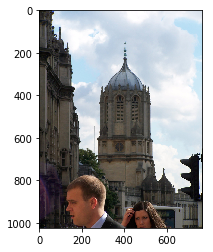

...

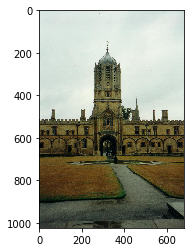

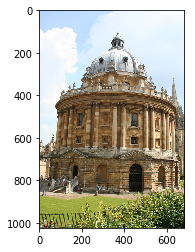

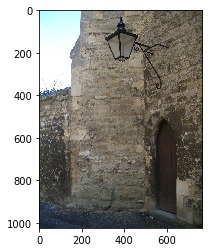

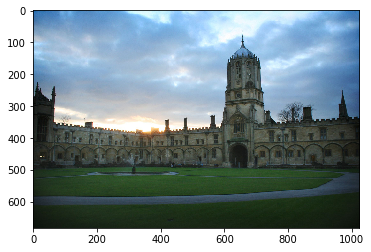

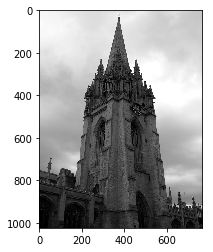

ap0 is 0.267249447134


0.26724944713375887

In [33]:
# the first query ap is 0.2672

debug = True
ap = []
params = {}
params['normalize'] = 2
params['pca'] = 0
features = preprocessing(out, normalize=2, pca=0)
compute_neighbors.counter = 0
K.clear_session()
image_dir = 'data/image/'

for file in query_list:
    if debug:
        print 'query file name is {}'.format(file)
    target = get_query(file, query_dir, image_name_test, out, image_dir='data/image/',
              crop = True, debug = debug)
    if False:
        print 'target is'
        print target
    _, target = preprocessing(out, query = target, params=params)
    if False:
        print 'after preprocessing, target is'
        print target
    
    neighbors = compute_neighbors2(target, features, debug = debug)
    rank = i2name(neighbors, name_dict)
    ap0 = compute_ap2(file, rank, query_dir, debug = debug, display_pos=True)
    ap.append(ap0)
    
    if debug:
        print 'rank'
        print rank[0:100]
        for image in rank[:100]:
            img = imread(image_dir+image+'.jpg')
            plt.imshow(img)
            plt.show()
    
    if debug:
        print 'ap0 is {}'.format(ap0)
    
    if True:
        break
    
np.mean(np.array(ap))

In [ ]:
# show correct image